In [1]:
import Interface as I

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/model_data_base/distributed_lock.py:11: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config = yaml.load(f)


trying to connect to distributed locking server {'config': {'hosts': 'somalogin02-hs:33333'}, 'type': 'zookeeper'}


Connection time-out: socket time-out during read


success!
Current version: v0.0.1+1271.gcce0b7a.dirty
Current pid: 84819


/gpfs/soma_fs/scratch/abast/anaconda3_isf/lib/python3.8/site-packages/pandas_msgpack-0+unknown-py3.8-linux-x86_64.egg/pandas_msgpack/packers.py:78: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import (Timestamp, Period, Series, DataFrame,  # noqa


Loading mechanisms:
setting up local multiprocessing framework ... done


Loaded modules with __version__ attribute are:
IPython: 7.19.0, Interface: v0.0.1+1271.gcce0b7a.dirty, PIL: 8.2.0, _csv: 1.0, _ctypes: 1.1.0, _curses: b'2.2', _decimal: 1.70, argparse: 1.1, backcall: 0.2.0, blosc: 1.10.2, bluepyopt: 1.9.126, bottleneck: 1.3.2, cffi: 1.14.3, click: 7.1.2, cloudpickle: 1.6.0, colorama: 0.4.4, csv: 1.0, ctypes: 1.1.0, cycler: 0.10.0, cytoolz: 0.11.0, dask: 2.30.0, dateutil: 2.8.1, deap: 1.3, decimal: 1.70, decorator: 4.4.2, distributed: 2.30.1, distutils: 3.8.5, fsspec: 0.8.3, future: 0.18.2, ipykernel: 5.3.4, ipython_genutils: 0.2.0, ipywidgets: 7.5.1, jedi: 0.17.1, jinja2: 2.11.2, joblib: 0.17.0, json: 2.0.9, jupyter_client: 6.1.7, jupyter_core: 4.6.3, kazoo: 2.8.0, kiwisolver: 1.3.0, logging: 0.5.1.2, markupsafe: 1.1.1, matplotlib: 3.3.2, mkl: 2.3.0, neuron: 7.8.2, numexpr: 2.7.1, numpy: 1.19.2, pandas: 1.1.3, pandas_msgpack: 0+unknown, parameters: 0.2.1, parso: 0.7.0, past: 0.18

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/Interface.py:183: UserWarning:

The source folder has uncommited changes!



In [2]:
mdb = I.ModelDataBase('/gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey')

In [3]:
df_all['morphology'].drop_duplicates()

NameError: name 'df_all' is not defined

In [ ]:
mdb_biophyics.basedir

# copy relevant data

## simulator objects

In [13]:
mdb_biophysics_py3_BAC2_step = I.ModelDataBase('/gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step')

In [ ]:
######
# note: I just copy the latest version of models. 
# They fix the following problems with the previous models
######
# this cells contains old optimizations used for energy paper. There are some issues with these models
# - simulator is python 2
# - voltage traces are not resampled, which leads to high variance in Ca-AP width
# - creating an additional compartment in NEURON that is required to initialize the hay optimizer, but which changes the numerics of the variable time step solver
# - compartment size is not limited (now limited to 50 micron)
# - no guarantee to use "outside_scale" density on Ca_HVA or Ca_LVAst if soma distance of obliques overlaps with hot zone distance on trunk
# - not fitting the DI3 stimulus
# - calcium kinetics not initialized at rest
######

In [15]:
morphologies = ['89', '90', 'WR69', '88', '93', '84', '87', 'WR64', '85', '86', '91', 'WR71']

In [21]:
keys_to_copy = ['fixed_params', 'get_fixed_params', 'params', 'get_Simulator', 'get_Evaluator', 'get_Combiner']
for m in morphologies:
    m2 = mdb.create_sub_mdb(m, raise_ = False)    
    #for k in keys_to_copy:
    #    m2[k] = mdb_biophysics_py3_BAC2_step[m][k]
    target_dir = m2.create_managed_folder('morphology', raise_ = False)
    source_dir = mdb_biophysics_py3_BAC2_step[m]['morphology']
    print('!rsync {} {} -av'.format(source_dir + '/', target_dir + '/'))

!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/89_r7dr3xz7_/mdb/morphology_le6tfw7c_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/89_p36liaso_/mdb/morphology_k2bakguw_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/90_p0yebc2j_/mdb/morphology_316_yebo_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/90_4fbgn3sm_/mdb/morphology_6igkwvb2_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/wr69_4te3iw6b_/mdb/morphology_c8qqxa8i_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr69_jec1go32_/mdb/morphology_sge9jrgx_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/88_3q51cdzv_/mdb/morphology_t6cjtz6h_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/88_bh13agz6_/mdb/morphology_16j

In [22]:
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/89_r7dr3xz7_/mdb/morphology_le6tfw7c_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/89_p36liaso_/mdb/morphology_k2bakguw_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/90_p0yebc2j_/mdb/morphology_316_yebo_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/90_4fbgn3sm_/mdb/morphology_6igkwvb2_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/wr69_4te3iw6b_/mdb/morphology_c8qqxa8i_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr69_jec1go32_/mdb/morphology_sge9jrgx_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/88_3q51cdzv_/mdb/morphology_t6cjtz6h_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/88_bh13agz6_/mdb/morphology_16jchq9p_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/93_bgmohvju_/mdb/morphology_35pn38kf_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/93_tsuyxycm_/mdb/morphology_fcu_a3f__/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/84_fj0n75up_/mdb/morphology_m6aesnuz_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/84_lg_ofiqz_/mdb/morphology_4kxhthaf_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/87_4y0gkuui_/mdb/morphology_47b71s4b_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/87_5k00fz88_/mdb/morphology_pk0zci_c_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/wr64_5u8jjpef_/mdb/morphology__gxzdriz_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr64_q58971um_/mdb/morphology__ndkyt2e_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/85_y_efv5st_/mdb/morphology_cr1_ltei_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/85_6m7a4r1h_/mdb/morphology_rm5txr38_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/86_7xx6fpal_/mdb/morphology_w3phro53_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/86_e49qf0d6_/mdb/morphology_08rrxo3l_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/91_717kejvg_/mdb/morphology_yv4t2y2g_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/91_jf6a8rh__/mdb/morphology_aemxn6si_/ -av
!rsync /gpfs/soma_fs/scratch/abast/results/20220325_run_low_refractory_period_optimization3_two_BAC_plus_step/wr71_bnihwiry_/mdb/morphology_kkerzn3n_/ /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr71_kcwjml3o_/mdb/morphology_8_1d74zg_/ -av

sending incremental file list
./
89_L5_CDK20050712_nr6L5B_dend_PC_neuron_transform_registered_C2.hoc
Loader.pickle

sent 992,616 bytes  received 57 bytes  1,985,346.00 bytes/sec
total size is 992,123  speedup is 1.00
sending incremental file list
./
90_L5_CDK20050720_nr7L5B_dend_PC_neuron_transform_registered_C2.hoc
Loader.pickle

sent 376,959 bytes  received 57 bytes  754,032.00 bytes/sec
total size is 376,618  speedup is 1.00
sending incremental file list
./
Loader.pickle
WR69_Cell2_L5TT.hoc

sent 530,682 bytes  received 57 bytes  1,061,478.00 bytes/sec
total size is 530,345  speedup is 1.00
sending incremental file list
./
88_L5_CDK20050707_nr5L5B_dend_PC_neuron_transform_registered_C2.hoc
Loader.pickle

sent 361,584 bytes  received 57 bytes  723,282.00 bytes/sec
total size is 361,243  speedup is 1.00
sending incremental file list
./
93_L5_CDK20060808_nr10L5B_dend_PC_neuron_transform_registered_C2.hoc
Loader.pickle

sent 598,476 bytes  received 57 bytes  1,197,066.00 bytes/sec
total

## examplary models

In [23]:
mdb_biophyics = I.ModelDataBase('/gpfs/soma_fs/scratch/abast/results/20221020_hot_zone_biophysical_composition')

In [27]:
df = mdb_biophyics['df_all_selected']
df.head()
df = df[df['optim_id'] == 'step']

In [35]:
mdb['examplary_models'] = df

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/model_data_base/model_data_base.py:526: UserWarning:

The database source folder has uncommitted changes!



In [118]:
## all models optimized for bAP + BAC, + BAC2 + STEP1/2/3
df_all = df_all = mdb_biophyics['selected_BAC2_step_1']
mdb.setitem('df_all', df_all, dumper = I.dumper_pandas_to_msgpack)

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/model_data_base/model_data_base.py:526: UserWarning:

The database source folder has uncommitted changes!



# this should run on mickeys side

## setup

In [1]:
import Interface as I

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/model_data_base/distributed_lock.py:11: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  config = yaml.load(f)


trying to connect to distributed locking server {'config': {'hosts': 'somalogin02-hs:33333'}, 'type': 'zookeeper'}
success!
Current version: v0.0.1+1271.gcce0b7a.dirty
Current pid: 88216


/gpfs/soma_fs/scratch/abast/anaconda3_isf/lib/python3.8/site-packages/pandas_msgpack-0+unknown-py3.8-linux-x86_64.egg/pandas_msgpack/packers.py:78: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import (Timestamp, Period, Series, DataFrame,  # noqa


Loading mechanisms:
setting up local multiprocessing framework ... done


Loaded modules with __version__ attribute are:
IPython: 7.19.0, Interface: v0.0.1+1271.gcce0b7a.dirty, PIL: 8.2.0, _csv: 1.0, _ctypes: 1.1.0, _curses: b'2.2', _decimal: 1.70, argparse: 1.1, backcall: 0.2.0, blosc: 1.10.2, bluepyopt: 1.9.126, bottleneck: 1.3.2, cffi: 1.14.3, click: 7.1.2, cloudpickle: 1.6.0, colorama: 0.4.4, csv: 1.0, ctypes: 1.1.0, cycler: 0.10.0, cytoolz: 0.11.0, dask: 2.30.0, dateutil: 2.8.1, deap: 1.3, decimal: 1.70, decorator: 4.4.2, distributed: 2.30.1, distutils: 3.8.5, fsspec: 0.8.3, future: 0.18.2, ipykernel: 5.3.4, ipython_genutils: 0.2.0, ipywidgets: 7.5.1, jedi: 0.17.1, jinja2: 2.11.2, joblib: 0.17.0, json: 2.0.9, jupyter_client: 6.1.7, jupyter_core: 4.6.3, kazoo: 2.8.0, kiwisolver: 1.3.0, logging: 0.5.1.2, markupsafe: 1.1.1, matplotlib: 3.3.2, mkl: 2.3.0, neuron: 7.8.2, numexpr: 2.7.1, numpy: 1.19.2, pandas: 1.1.3, pandas_msgpack: 0+unknown, parameters: 0.2.1, parso: 0.7.0, past: 0.18

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/Interface.py:183: UserWarning:

The source folder has uncommited changes!



In [2]:
%matplotlib inline

In [3]:
mdb = I.ModelDataBase('/gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey') # adapt path to your local one

In [4]:
import project_specific_ipynb_code.biophysical_models

In [5]:
# init
objectives_BAC = project_specific_ipynb_code.biophysical_models.objectives_BAC
objectives_step = project_specific_ipynb_code.biophysical_models.objectives_step
objectives_2BAC = ['1BAC_APheight', '1BAC_ISI', '1BAC_ahpdepth', '1BAC_caSpike_height', '1BAC_caSpike_width', '1BAC_spikecount', '2BAC_APheight', '2BAC_ISI', '2BAC_ahpdepth', '2BAC_caSpike_height', '2BAC_caSpike_width', '2BAC_spikecount', 'bAP_APheight', 'bAP_APwidth', 'bAP_att2', 'bAP_att3', 'bAP_spikecount']

params_py2 = ['ephys.CaDynamics_E2.apic.decay',
       'ephys.CaDynamics_E2.apic.gamma', 'ephys.CaDynamics_E2.axon.decay',
       'ephys.CaDynamics_E2.axon.gamma', 'ephys.CaDynamics_E2.soma.decay',
       'ephys.CaDynamics_E2.soma.gamma', 'ephys.Ca_HVA.apic.gCa_HVAbar',
       'ephys.Ca_HVA.axon.gCa_HVAbar', 'ephys.Ca_HVA.soma.gCa_HVAbar',
       'ephys.Ca_LVAst.apic.gCa_LVAstbar', 'ephys.Ca_LVAst.axon.gCa_LVAstbar',
       'ephys.Ca_LVAst.soma.gCa_LVAstbar', 'ephys.Im.apic.gImbar',
       'ephys.K_Pst.axon.gK_Pstbar', 'ephys.K_Pst.soma.gK_Pstbar',
       'ephys.K_Tst.axon.gK_Tstbar', 'ephys.K_Tst.soma.gK_Tstbar',
       'ephys.NaTa_t.apic.gNaTa_tbar', 'ephys.NaTa_t.axon.gNaTa_tbar',
       'ephys.NaTa_t.soma.gNaTa_tbar', 'ephys.Nap_Et2.axon.gNap_Et2bar',
       'ephys.Nap_Et2.soma.gNap_Et2bar', 'ephys.SK_E2.apic.gSK_E2bar',
       'ephys.SK_E2.axon.gSK_E2bar', 'ephys.SK_E2.soma.gSK_E2bar',
       'ephys.SKv3_1.apic.gSKv3_1bar', 'ephys.SKv3_1.apic.offset',
       'ephys.SKv3_1.apic.slope', 'ephys.SKv3_1.axon.gSKv3_1bar',
       'ephys.SKv3_1.soma.gSKv3_1bar', 'ephys.none.apic.g_pas',
       'ephys.none.axon.g_pas', 'ephys.none.dend.g_pas',
       'ephys.none.soma.g_pas', 'scale_apical.scale']

params_py3 = [p.replace('ephys.CaDynamics_E2', 'ephys.CaDynamics_E2_v2') for p in params_py2]

In [7]:
# init
mdb_biophyics = I.ModelDataBase('/gpfs/soma_fs/scratch/abast/results/20221020_hot_zone_biophysical_composition')

In [8]:
# init
import pickle
import biophysics_fitting.hay_evaluation
import project_specific_ipynb_code.biophysical_models
from project_specific_ipynb_code.biophysical_models import get_model_ddf_from_encapsulating_mdb, objectives_BAC
from project_specific_ipynb_code.biophysical_models import get_ddf_selected
from project_specific_ipynb_code.hot_zone import get_cell_object_from_hoc
from project_specific_ipynb_code.biophysical_models import min_max_plot, normalize_params
from project_specific_ipynb_code.biophysical_models import CurrentAnalysis
from project_specific_ipynb_code.biophysical_models import modify_simulator_to_record_apical_dendrite_conductances

In [9]:
# init
objectives_BAC = project_specific_ipynb_code.biophysical_models.objectives_BAC
objectives_step = project_specific_ipynb_code.biophysical_models.objectives_step
objectives_2BAC = ['1BAC_APheight', '1BAC_ISI', '1BAC_ahpdepth', '1BAC_caSpike_height', '1BAC_caSpike_width', '1BAC_spikecount', '2BAC_APheight', '2BAC_ISI', '2BAC_ahpdepth', '2BAC_caSpike_height', '2BAC_caSpike_width', '2BAC_spikecount', 'bAP_APheight', 'bAP_APwidth', 'bAP_att2', 'bAP_att3', 'bAP_spikecount']

In [10]:
# they are the same for all optimizations with the exception of CaDynamics_E2 (py2 simulations) 
# and CaDynamics_E2_v2 (py3 simulations)

params_py2 = ['ephys.CaDynamics_E2.apic.decay',
       'ephys.CaDynamics_E2.apic.gamma', 'ephys.CaDynamics_E2.axon.decay',
       'ephys.CaDynamics_E2.axon.gamma', 'ephys.CaDynamics_E2.soma.decay',
       'ephys.CaDynamics_E2.soma.gamma', 'ephys.Ca_HVA.apic.gCa_HVAbar',
       'ephys.Ca_HVA.axon.gCa_HVAbar', 'ephys.Ca_HVA.soma.gCa_HVAbar',
       'ephys.Ca_LVAst.apic.gCa_LVAstbar', 'ephys.Ca_LVAst.axon.gCa_LVAstbar',
       'ephys.Ca_LVAst.soma.gCa_LVAstbar', 'ephys.Im.apic.gImbar',
       'ephys.K_Pst.axon.gK_Pstbar', 'ephys.K_Pst.soma.gK_Pstbar',
       'ephys.K_Tst.axon.gK_Tstbar', 'ephys.K_Tst.soma.gK_Tstbar',
       'ephys.NaTa_t.apic.gNaTa_tbar', 'ephys.NaTa_t.axon.gNaTa_tbar',
       'ephys.NaTa_t.soma.gNaTa_tbar', 'ephys.Nap_Et2.axon.gNap_Et2bar',
       'ephys.Nap_Et2.soma.gNap_Et2bar', 'ephys.SK_E2.apic.gSK_E2bar',
       'ephys.SK_E2.axon.gSK_E2bar', 'ephys.SK_E2.soma.gSK_E2bar',
       'ephys.SKv3_1.apic.gSKv3_1bar', 'ephys.SKv3_1.apic.offset',
       'ephys.SKv3_1.apic.slope', 'ephys.SKv3_1.axon.gSKv3_1bar',
       'ephys.SKv3_1.soma.gSKv3_1bar', 'ephys.none.apic.g_pas',
       'ephys.none.axon.g_pas', 'ephys.none.dend.g_pas',
       'ephys.none.soma.g_pas', 'scale_apical.scale']

params_py3 = [p.replace('ephys.CaDynamics_E2', 'ephys.CaDynamics_E2_v2') for p in params_py2]

## example simulation

In [11]:
morphology = 'WR64'

def get_simulator(id_, py2 = False):
    s = mdb[id_]['get_Simulator'](mdb[id_])
    return s

def get_evaluator(id_):
    e = mdb[id_]['get_Evaluator'](mdb[id_])
    return e

def get_fixed_params(id_):
    fp = mdb[id_]['get_fixed_params'](mdb[id_])
    return fp

# get simulator and evaluator object for a specific morphology
s = get_simulator('WR64')
e = get_evaluator('WR64')

In [12]:
df = mdb['examplary_models']

In [13]:
# get the biophysical parameters of one examplary biophysical model
p = df.iloc[0][params_py3]
p

ephys.CaDynamics_E2_v2.apic.decay        55.1313
ephys.CaDynamics_E2_v2.apic.gamma      0.0005357
ephys.CaDynamics_E2_v2.axon.decay        143.024
ephys.CaDynamics_E2_v2.axon.gamma     0.00445041
ephys.CaDynamics_E2_v2.soma.decay        668.442
ephys.CaDynamics_E2_v2.soma.gamma     0.00549685
ephys.Ca_HVA.apic.gCa_HVAbar          0.00489763
ephys.Ca_HVA.axon.gCa_HVAbar         0.000584527
ephys.Ca_HVA.soma.gCa_HVAbar         2.59393e-05
ephys.Ca_LVAst.apic.gCa_LVAstbar      0.00035929
ephys.Ca_LVAst.axon.gCa_LVAstbar     0.000244502
ephys.Ca_LVAst.soma.gCa_LVAstbar     0.000190162
ephys.Im.apic.gImbar                 0.000564525
ephys.K_Pst.axon.gK_Pstbar             0.0879311
ephys.K_Pst.soma.gK_Pstbar             0.0351482
ephys.K_Tst.axon.gK_Tstbar               0.02997
ephys.K_Tst.soma.gK_Tstbar             0.0735116
ephys.NaTa_t.apic.gNaTa_tbar           0.0161037
ephys.NaTa_t.axon.gNaTa_tbar             1.31117
ephys.NaTa_t.soma.gNaTa_tbar             1.97784
ephys.Nap_Et2.axon.g

### run all stimulus protocols

In [14]:
voltage_traces = s.run(p)

-------------------------------
Starting setup of cell model...
Loading cell morphology...
Reading hoc file /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr64_q58971um_/mdb/morphology__ndkyt2e_/WR64_Cell8_L5TT_C2-registered.hocwith_radius_constant_mean.hoc
Creating AIS:
    axon hillock diameter: 3.00
    initial segment diameter: 1.75
    myelin diameter: 1.00
Setting up biophysical model...
    Adding membrane properties to AIS
    Adding membrane properties to ApicalDendrite
    Adding membrane properties to Dendrite
    Adding membrane properties to Myelin
    Adding membrane properties to Soma
    Setting up spatial discretization...
    frequency used for determining discretization: 100
    maximum segment length: 50
    Total number of compartments in model: 830
    Total length of model cell: 10451.70
    Average compartment length: 12.59
    Maximum compartment (ApicalDendrite) length: 40.81
    Adding membrane range mechanisms to AIS
        Inserting mechanism 

Connection dropped: socket connection broken


simulating StepThree took 13.397483587265015 seconds


Transition to CONNECTING
Session has expired


In [16]:
voltage_traces['bAP.hay_measure'].keys()

dict_keys(['tVec', 'vList'])

In [17]:
from project_specific_ipynb_code.biophysical_models import visualize_vt

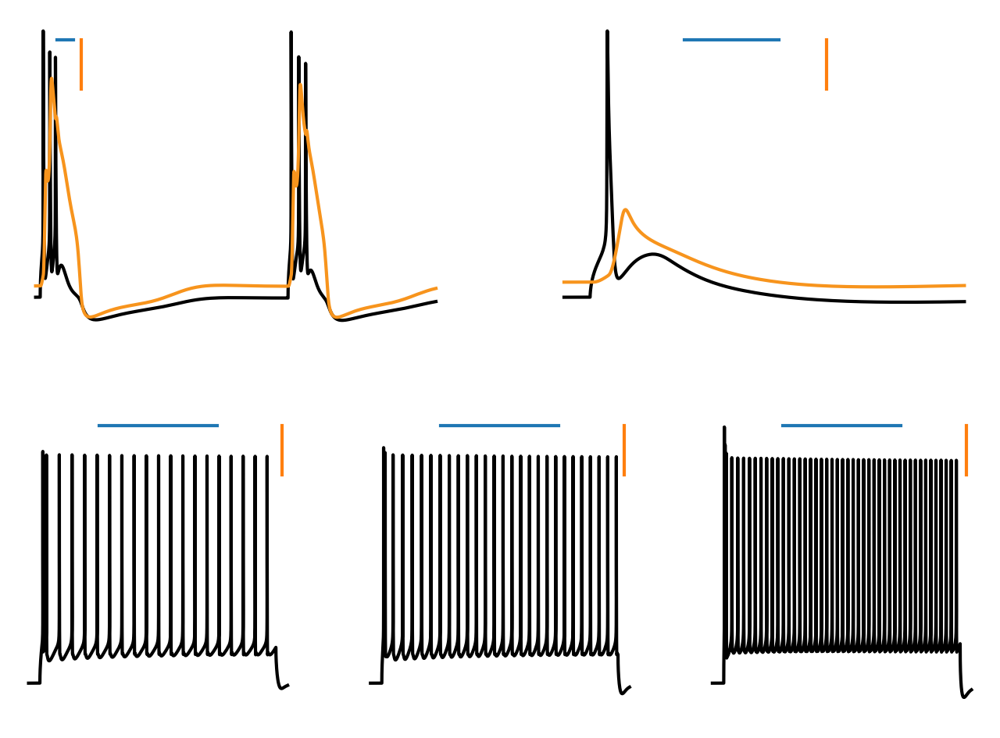

In [18]:
# visualize all responses
visualize_vt(voltage_traces)

In [19]:
e.evaluate(voltage_traces)

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/biophysics_fitting/hay_evaluation.py:37: UserWarning:

Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment) which has the purpose to 'just be there' such that the functionality necessary to evaluate voltage traces is available. This has the side effect that in the case of the variable time step solver, the timesteps can be changed.



	0 
	1 
	1 
	1 
	1 
	1 
	1 
	1 
	0 
	0 
full list is of length 5 
	0 
	0 
full list is of length 5 
	0 
	0 
	0 
	0 
record path is ga_result_89_CDK20050712_BAC_run1_seed_4567
population file is random
called load population
ga_result_86_CDK20041214_BAC_run5_seed_4223/clean_population_file.txt
breed matrix rows 1000 
breed matrix columns 32 
population loaded from file
called load error
error matrix loaded from file
take_vec is 
0	0	
stim num is5 
4  files loaded successfuly
	1 
stat_mean Vector[1112] 
stat_std Vector[1113] 
punish 250 
use_control 0 
rep_num 2 
minspikenum 2 
stim_del 700 
stim_dur 2000 
apcvecList.o[0].size: 20 
feature_num 10 
Checking for minimum spike number...
Checking for returning to rest...
Checking for spikes before stimulus...
Calculating feature mean_frequency2
	Err: 1 
	STD: 0.88 
	norm. diff: 1.1363636 
Feature error: 1.1363636 
Calculating feature adaptation_index2
	Err: 0.0058737483 
	STD: 0.0091 
	norm. diff: 0.64546685 
Feature error: 0.64546685 
Calcu

/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/biophysics_fitting/hay_evaluation.py:37: UserWarning:

Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment) which has the purpose to 'just be there' such that the functionality necessary to evaluate voltage traces is available. This has the side effect that in the case of the variable time step solver, the timesteps can be changed.



	0 
	1 
	1 
	1 
	1 
	1 
	1 
	1 
	0 
	0 
full list is of length 5 
	0 
	0 
full list is of length 5 
	0 
	0 
	0 
	0 
record path is ga_result_89_CDK20050712_BAC_run1_seed_4567
population file is random
called load population
ga_result_86_CDK20041214_BAC_run5_seed_4223/clean_population_file.txt
breed matrix rows 1000 
breed matrix columns 32 
population loaded from file
called load error
error matrix loaded from file
take_vec is 
0	0	
stim num is5 
4  files loaded successfuly
	1 
stat_mean Vector[1116] 
stat_std Vector[1117] 
punish 250 
use_control 0 
rep_num 3 
minspikenum 2 
stim_del 700 
stim_dur 2000 
apcvecList.o[0].size: 28 
feature_num 10 
Checking for minimum spike number...
Checking for returning to rest...
Checking for spikes before stimulus...
Calculating feature mean_frequency2
	Err: 0.5 
	STD: 0.56 
	norm. diff: 0.89285714 
Feature error: 0.89285714 
Calculating feature adaptation_index2
	Err: 0.00065462044 
	STD: 0.0056 
	norm. diff: 0.11689651 
Feature error: 0.11689651 


/gpfs/soma_fs/scratch/abast/project_src/in_silico_framework/biophysics_fitting/hay_evaluation.py:37: UserWarning:

Setting up hay evaluator. This loads several variables to the NEURON envioronment. Also, it creates a unconnected cell (which is very small ~ 1 compartment) which has the purpose to 'just be there' such that the functionality necessary to evaluate voltage traces is available. This has the side effect that in the case of the variable time step solver, the timesteps can be changed.



	0 
	1 
	1 
	1 
	1 
	1 
	1 
	1 
	0 
	0 
full list is of length 5 
	0 
	0 
full list is of length 5 
	0 
	0 
	0 
	0 
record path is ga_result_89_CDK20050712_BAC_run1_seed_4567
population file is random
called load population
ga_result_86_CDK20041214_BAC_run5_seed_4223/clean_population_file.txt
breed matrix rows 1000 
breed matrix columns 32 
population loaded from file
called load error
error matrix loaded from file
take_vec is 
0	0	
stim num is5 
4  files loaded successfuly
	1 
stat_mean Vector[1120] 
stat_std Vector[1121] 
punish 250 
use_control 0 
rep_num 4 
minspikenum 2 
stim_del 700 
stim_dur 2000 
apcvecList.o[0].size: 46 
feature_num 10 
Checking for minimum spike number...
Checking for returning to rest...
Checking for spikes before stimulus...
Calculating feature mean_frequency2
	Err: 0.5 
	STD: 2.2222 
	norm. diff: 0.22500225 
Feature error: 0.22500225 
Calculating feature adaptation_index2
	Err: 0.0095160701 
	STD: 0.0026 
	norm. diff: 3.6600269 
Feature error: 3.6600269 
C

{'1BAC_APheight.check_1AP': 'True',
 '1BAC_APheight.raw': array([33.42073171, 24.92312362, 22.82343796]),
 '1BAC_APheight.normalized': 0.7116113417089004,
 '1BAC_APheight': 0.7116113417089004,
 '1BAC_ISI.check_2_or_3_APs': 'True',
 '1BAC_ISI.check_repolarization': 'True',
 '1BAC_ISI.raw': 7.400000000000006,
 '1BAC_ISI.normalized': 2.9364799812140356,
 '1BAC_ISI': 2.9364799812140356,
 '1BAC_ahpdepth.check_2AP': 'True',
 '1BAC_ahpdepth.raw': array([-66.54573842, -63.86659201]),
 '1BAC_ahpdepth.normalized': 0.3348933016570532,
 '1BAC_ahpdepth': 0.3348933016570532,
 '1BAC_caSpike_height.check_1_Ca_AP': 'True',
 '1BAC_caSpike_height.check_>=2_Na_AP': 'True',
 '1BAC_caSpike_height.check_ca_max_after_nth_somatic_spike': 'True',
 '1BAC_caSpike_height.raw': 14.348528745193395,
 '1BAC_caSpike_height.normalized': 2.999420765824171,
 '1BAC_caSpike_height': 2.999420765824171,
 '1BAC_caSpike_width.check_1_Ca_AP': 'True',
 '1BAC_caSpike_width.raw': 40.72500000000002,
 '1BAC_caSpike_width.normalized':

### more fine grained control over the simulation

#### run just one stimulus and get cell object


In [55]:
cell, _ = s.get_simulated_cell(p, 'BAC')

-------------------------------
Starting setup of cell model...
Loading cell morphology...
Reading hoc file /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr64_q58971um_/mdb/morphology__ndkyt2e_/WR64_Cell8_L5TT_C2-registered.hocwith_radius_constant_mean.hoc
Creating AIS:
    axon hillock diameter: 3.00
    initial segment diameter: 1.75
    myelin diameter: 1.00
Setting up biophysical model...
    Adding membrane properties to AIS
    Adding membrane properties to ApicalDendrite
    Adding membrane properties to Dendrite
    Adding membrane properties to Myelin
    Adding membrane properties to Soma
    Setting up spatial discretization...
    frequency used for determining discretization: 100
    maximum segment length: 50
    Total number of compartments in model: 830
    Total length of model cell: 10451.70
    Average compartment length: 12.59
    Maximum compartment (ApicalDendrite) length: 40.81
    Adding membrane range mechanisms to AIS
        Inserting mechanism 

parallelMovieMaker
files are here: animation/animation_1bd3l72g/*.png



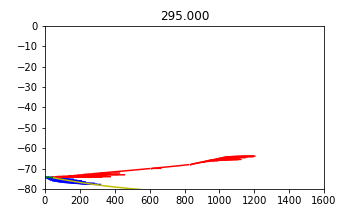
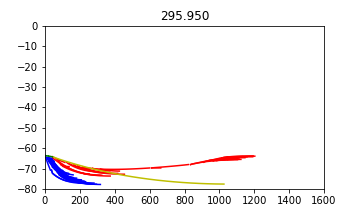
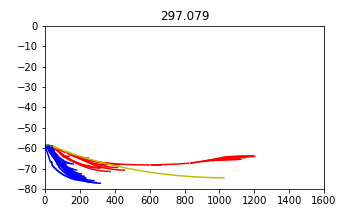
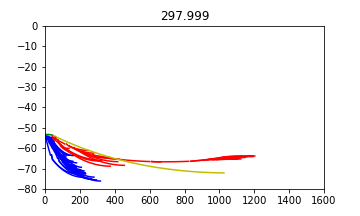
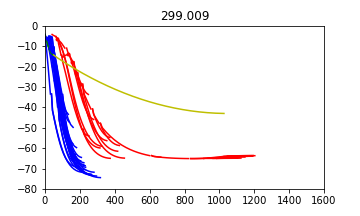
...
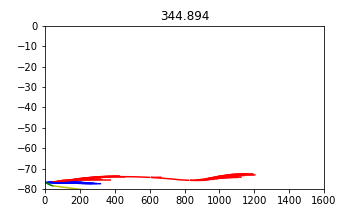
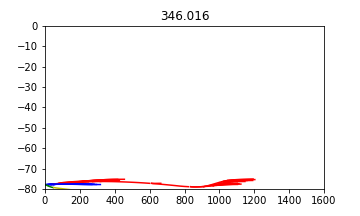
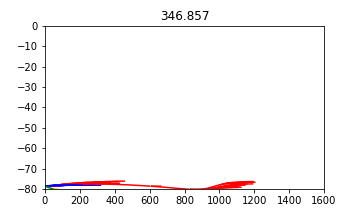
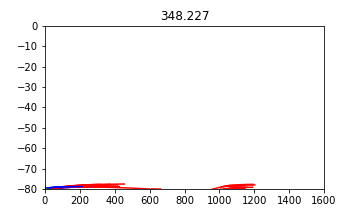
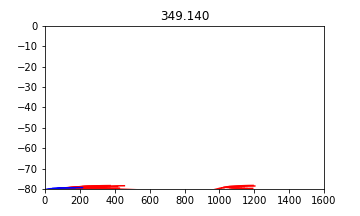

In [59]:
I.cell_to_ipython_animation(cell, tstart = 295, tend = 350, embedded = True)

In [60]:
import visualize

In [61]:
cmv = visualize.CellMorphologyVisualizer(cell)

In [124]:
client

Client Scheduler: tcp://10.102.3.86:38786 Dashboard: http://10.102.3.86:38787/status,Cluster Workers: 48 Cores: 48 Memory: 4.80 TB


Images already generated, they will not be generated again. Please, change the path name or delete the current one.



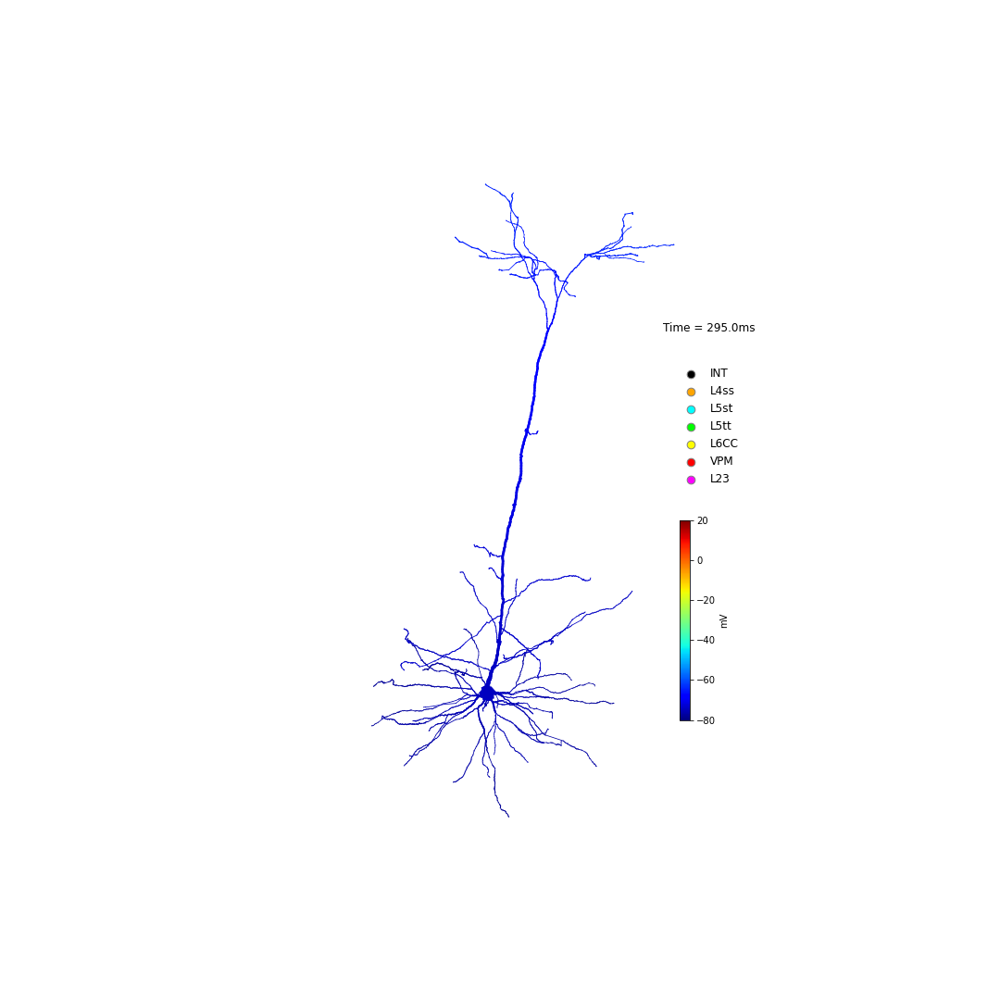
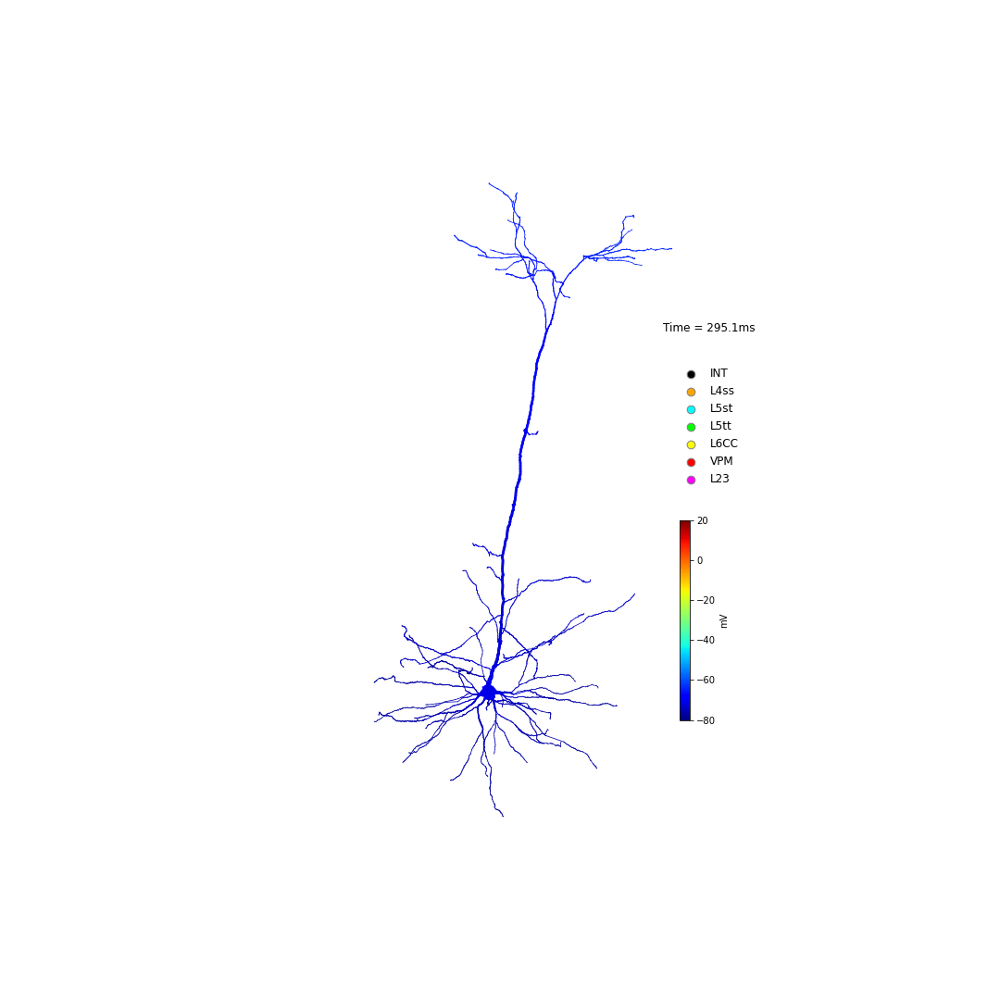
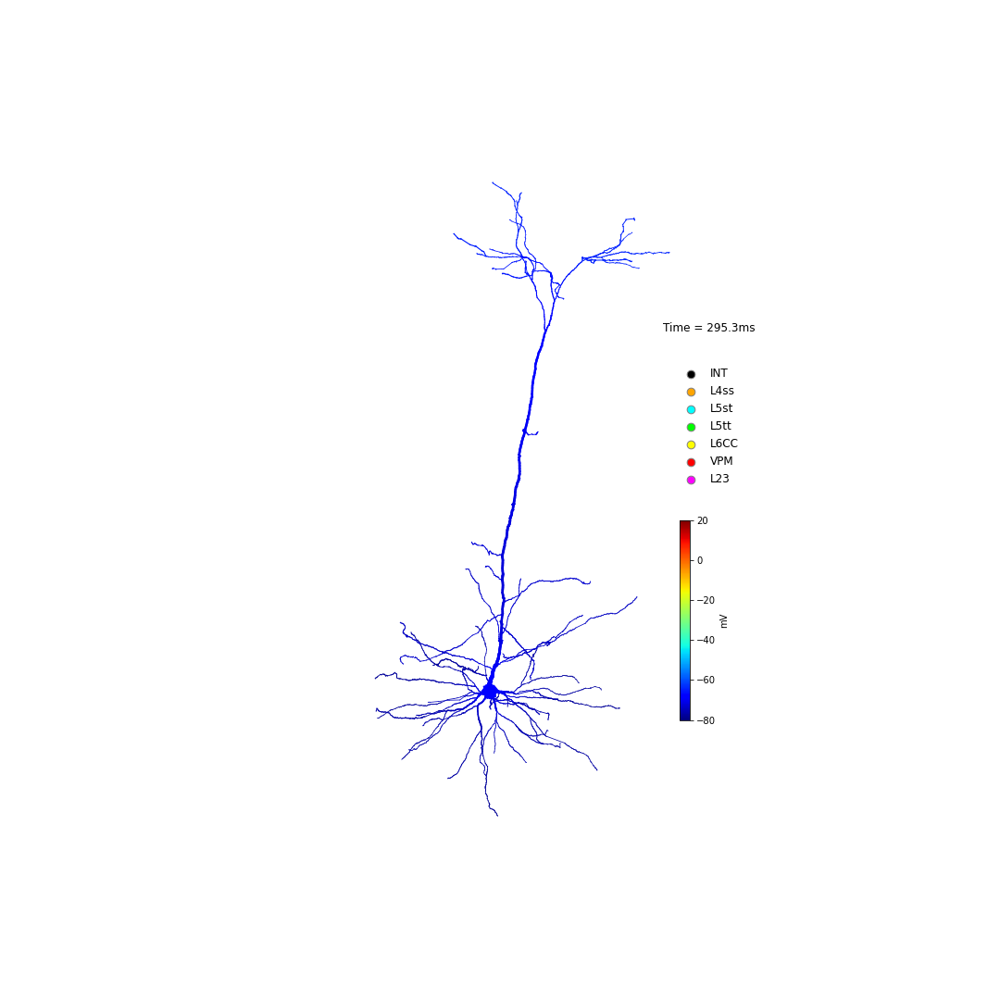
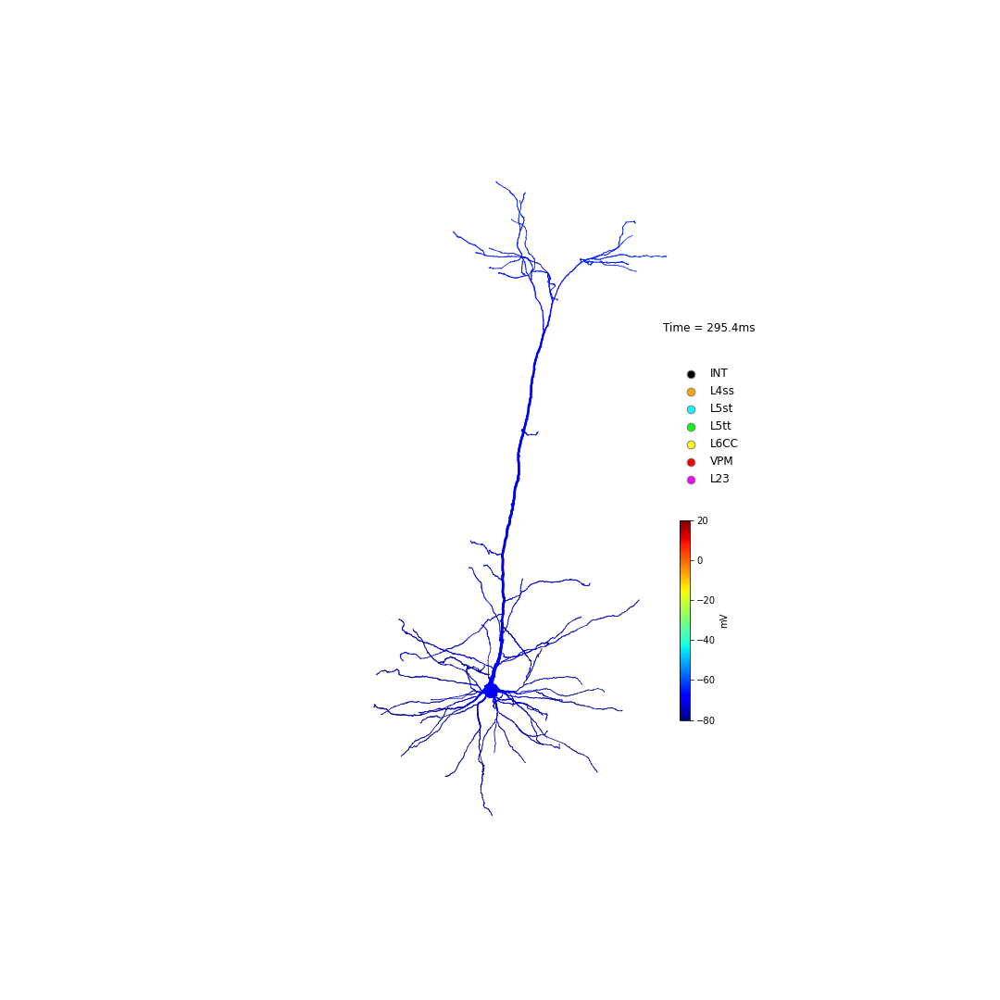
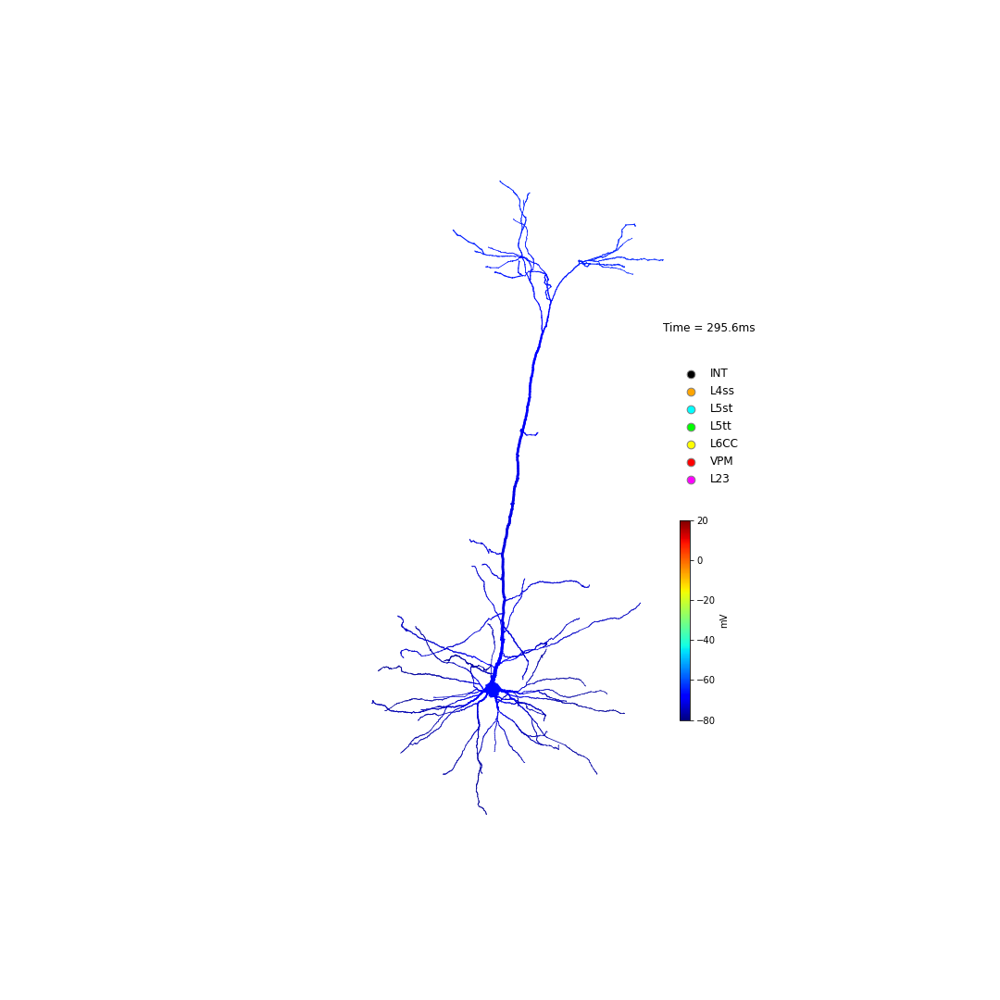
...
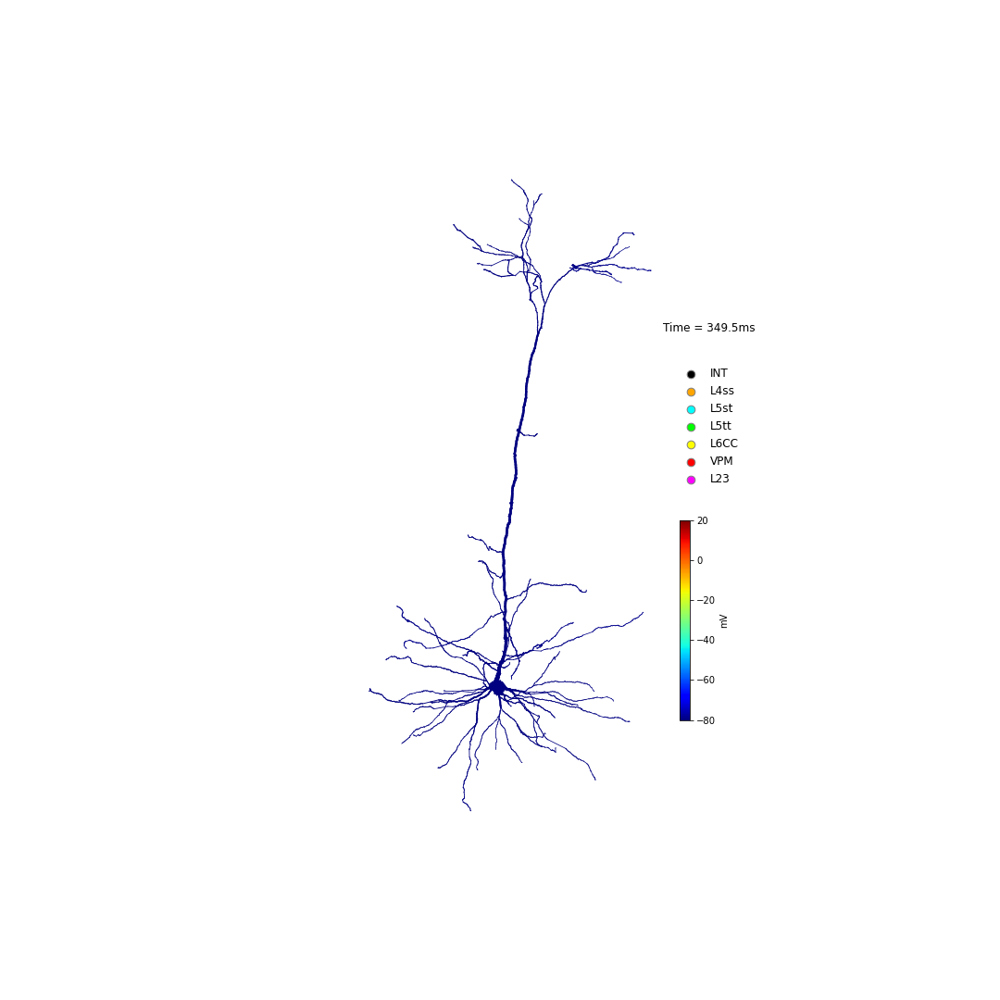
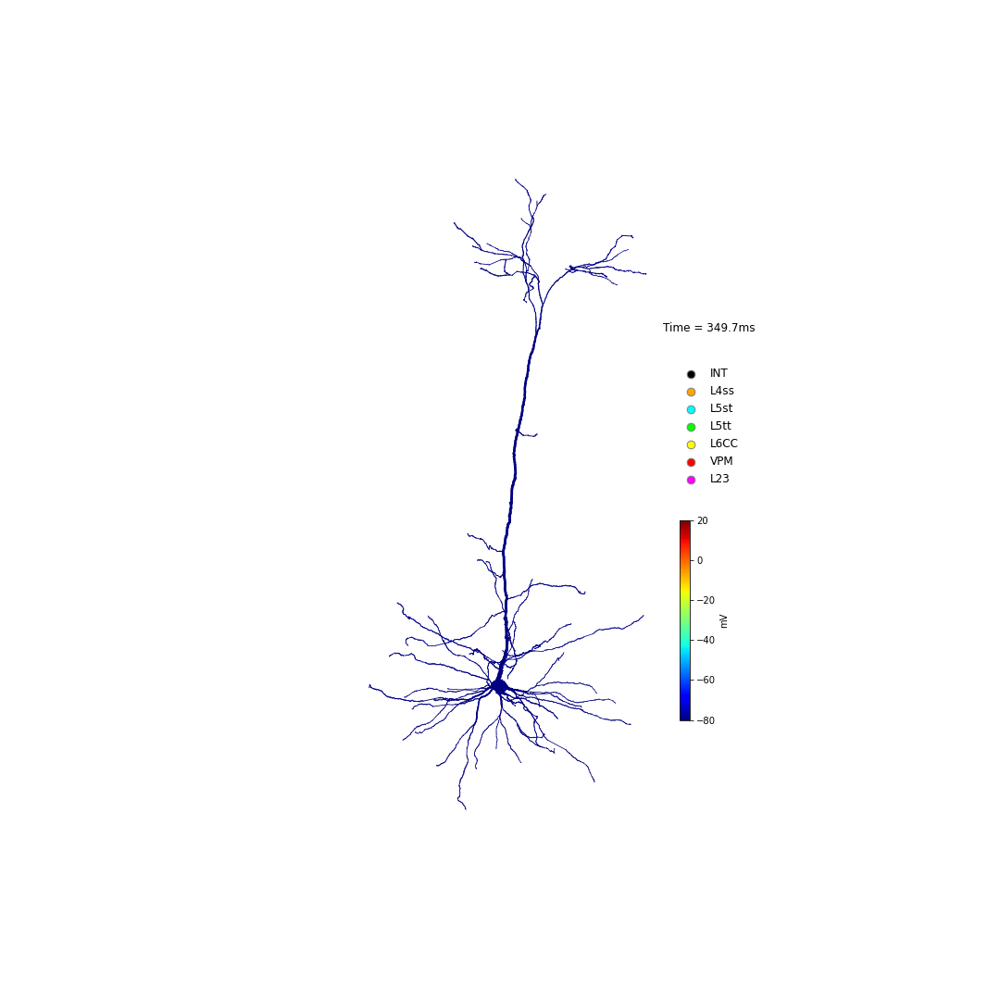
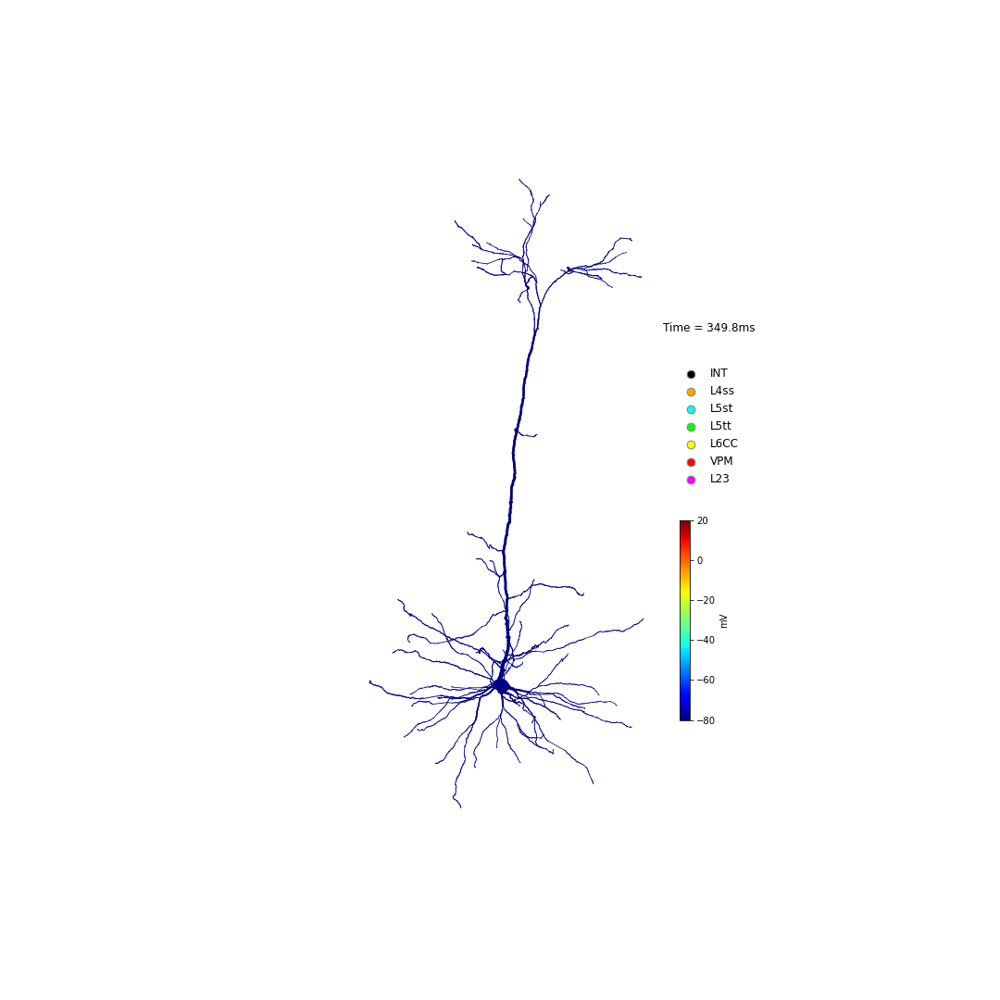
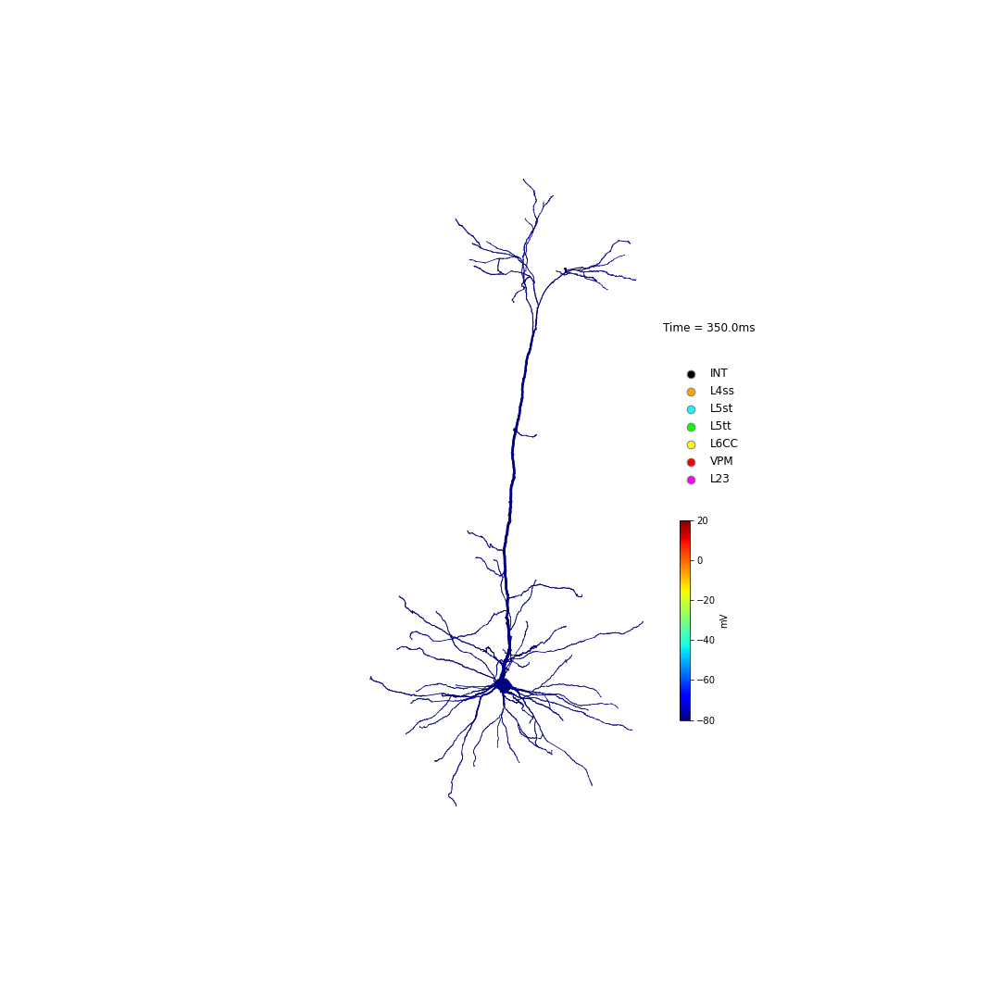
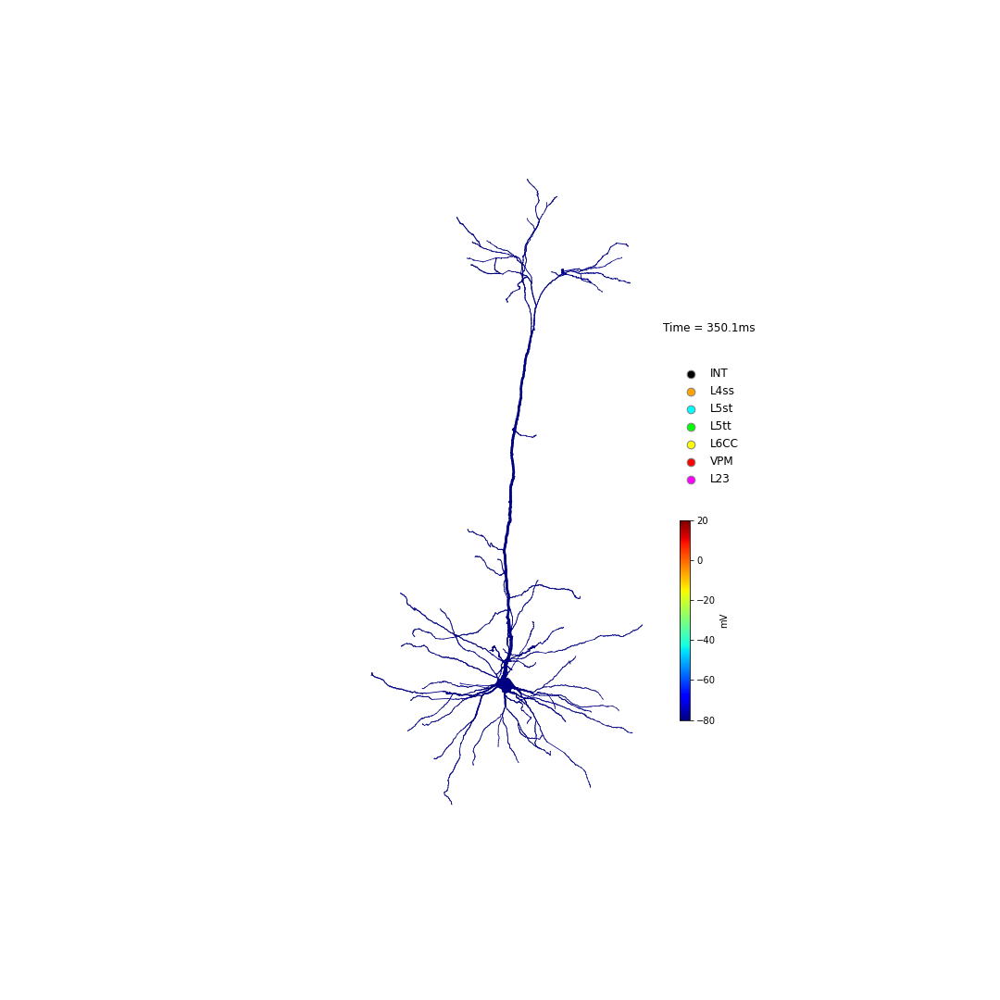

In [71]:
output_folder = '/gpfs/soma_fs/scratch/abast/animation01'
cmv.display_animation_voltage_synapses_in_morphology_3d(output_folder, client = client, t_start = 295, t_end = 350)

#### get neuron parameter dictionary and use this for simulation

In [76]:
neup = s.setup.get_cell_params_with_default_sim_prams(p)

In [143]:
# this is the corresponding change of channel density illustrated above using the low level interface
neup.neuron.ApicalDendrite['mechanisms']['range']['Ca_HVA']['gCa_HVAbar'] = 0.01#.keys()

0.004897627926942166

In [74]:
cell = I.scp.create_cell(neup.neuron)

-------------------------------
Starting setup of cell model...
Loading cell morphology...
Reading hoc file /gpfs/soma_fs/scratch/abast/results/20230301_meeting_mickey/wr64_q58971um_/mdb/morphology__ndkyt2e_/WR64_Cell8_L5TT_C2-registered.hocwith_radius_constant_mean.hoc
Creating AIS:
    axon hillock diameter: 3.00
    initial segment diameter: 1.75
    myelin diameter: 1.00
Setting up biophysical model...
    Adding membrane properties to AIS
    Adding membrane properties to ApicalDendrite
    Adding membrane properties to Dendrite
    Adding membrane properties to Myelin
    Adding membrane properties to Soma
    Setting up spatial discretization...
    frequency used for determining discretization: 100
    maximum segment length: 50
    Total number of compartments in model: 830
    Total length of model cell: 10451.70
    Average compartment length: 12.59
    Maximum compartment (ApicalDendrite) length: 40.81
    Adding membrane range mechanisms to AIS
        Inserting mechanism 

In [78]:
neup.sim

{'tStart': 0.0,
 'tStop': 295,
 'dt': 0.025,
 'Vinit': -75.0,
 'T': 34.0,
 'recordingSites': []}

In [79]:
sim_params = I.scp.NTParameterSet({'tStart': 0.0,'tStop': 295+55,'dt': 0.025,'Vinit': -75.0,'T': 34.0,'recordingSites': []})
I.scp.init_neuron_run(sim_params, vardt = True)

In [82]:
t = I.np.array(cell.tVec) # time

In [83]:
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

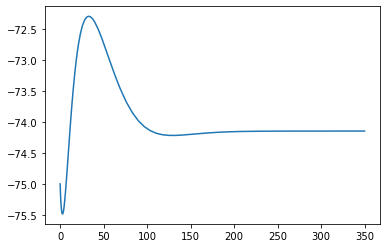

In [85]:
# no stimulus set up, steady state reached at around 200 ms
I.plt.plot(t,v)

In [86]:
## lets add a current injection to to soma

In [88]:
from neuron import h
iclamp = h.IClamp(0.5, sec=cell.soma)
iclamp.delay = 295 # give the cell time to reach steady state
iclamp.dur = 5 # 5ms rectangular pulse
iclamp.amp = 1.9 # 1.9 ?? todo ampere

In [89]:
sim_params = I.scp.NTParameterSet({'tStart': 0.0,'tStop': 295+55,'dt': 0.025,'Vinit': -75.0,'T': 34.0,'recordingSites': []})
I.scp.init_neuron_run(sim_params, vardt = True)

In [90]:
t = I.np.array(cell.tVec) # time

In [91]:
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

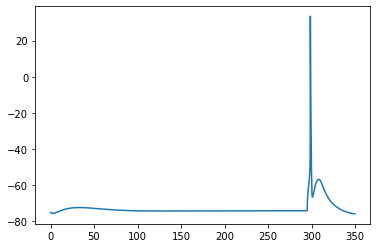

In [92]:
# no stimulus set up, steady state reached at around 200 ms
I.plt.plot(t,v)

In [93]:
### let's add the dendritic current injection
from biophysics_fitting.setup_stim import setup_apical_epsp_injection

In [97]:
# which soma distance?
get_fixed_params('WR64')['BAC.stim.dist']

663.0996147066406

In [98]:
setup_apical_epsp_injection(cell, dist = 663.0996147066406, amplitude = 0.5, delay = 300, rise = 1.0, decay = 5)

In [99]:
I.scp.init_neuron_run(sim_params, vardt = True)

In [100]:
t = I.np.array(cell.tVec) # time

In [101]:
v = I.np.array(cell.sections[0].recVList[0]) # soma voltage trace

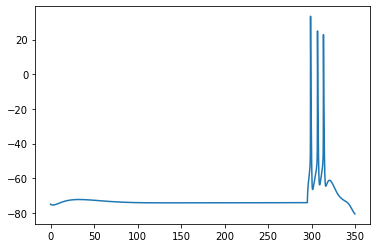

In [102]:
# no stimulus set up, steady state reached at around 200 ms
I.plt.plot(t,v)

## record apical conductance and make current contribution plot

In [69]:
# from project_specific_ipynb_code.biophysical_models import modify_simulator_to_record_apical_dendrite_conductances

In [105]:
rangeVarsApical = project_specific_ipynb_code.biophysical_models.rangeVarsApical

In [145]:
rangeVarsApical

['NaTa_t.ina',
 'Ca_HVA.ica',
 'Ca_LVAst.ica',
 'SKv3_1.ik',
 'SK_E2.ik',
 'Ih.ihcn',
 'Im.ik']

In [106]:
for rv in rangeVarsApical:
    cell.record_range_var(rv)

In [108]:
I.scp.init_neuron_run(sim_params, vardt = True)

In [109]:
colormap = {'Ca_HVA.ica': '#4682C3',
 'Ca_LVAst.ica': '#ACD7E4',
 'Ih.ihcn': '#838383',
 'Im.ik': '#F2E500',
 'NaTa_t.ina': '#EE781C',
 'SK_E2.ik': '#06652E',
 'SKv3_1.ik': '#9BC985'}

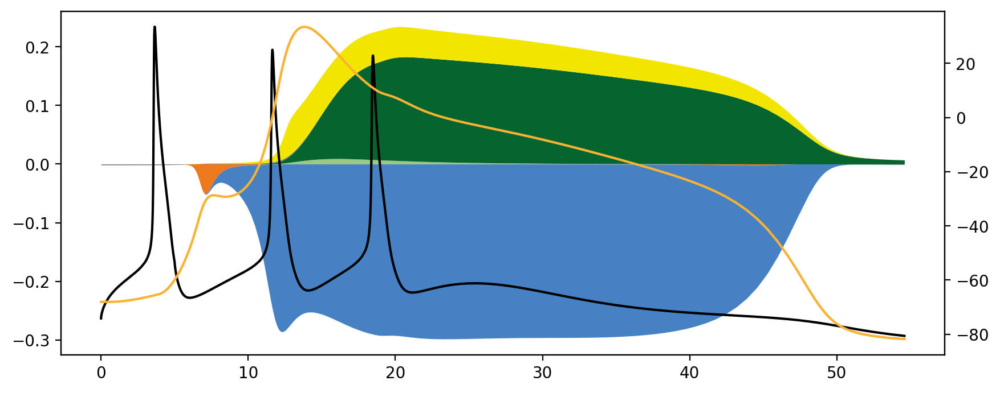

In [110]:
ca = project_specific_ipynb_code.biophysical_models.CurrentAnalysis(cell, colormap=colormap, rangeVars = rangeVarsApical)
ca.plot_areas(plot_voltage = True, t_stim=295, select_window_relative_to_stim=(0,700))